In [1]:
import velvet as vt

# general packages
import numpy as np
import pandas as pd
import torch
from scipy.sparse import issparse

# velocity packages
import scanpy as sc
import scvelo as scv
import anndata as ann

# plotting packages
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm, trange
from IPython.display import clear_output

# color palette object
from colors import colorpalette as colpal

Global seed set to 0
/camp/home/maizelr/.local/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/camp/home/maizelr/.local/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
import torchsde

In [3]:
adata0 = vt.pp.read("../data/celltyped_adata.h5ad")
adata0 = adata0[adata0.obs.cell_annotation!='other']
adata0

View of AnnData object with n_obs × n_vars = 44713 × 24967
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'doublet_score', 'marker_based_classification', 'cell_annotation'
    layers: 'new', 'old', 'total'

In [9]:
nt_types = ['MN', 'V3', 'p3','FP']

nmp = adata0[[ct not in nt_types for ct in adata0.obs.cell_annotation]]

nmp = nmp[[tp not in ['D3','D6','D7','D8'] for tp in nmp.obs.timepoint]]

nmp_genes = vt.pp.select_genes(
    nmp[nmp.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep', 
    curated_list=genes_to_include
)
    
nmp = vt.pp.size_normalize(
    nmp, 
    genes=nmp_genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

vt.pp.neighborhood(nmp, n_neighbors=100)

Using ScanPy methods to calculate distances, indices, connectivities, transitions, ... done! 
KNN indices for Velvet stored in .obsm['knn_index'].
Dense similarity transition matrix for Velvet stored in .obsm['Ts'].


In [10]:
nmp = nmp.copy()

vt.ut.set_seed(0)

vt.md.Velvet.setup_anndata(nmp, x_layer='total', n_layer='new', knn_layer='knn_index')

model = vt.md.Velvet(
    nmp,
    n_latent = 50,
    linear_decoder = True,
    neighborhood_space="latent_space",
    biophysical_model = "full",
    gamma_mode = "learned",
    labelling_time = 2.0,
)

model.setup_model()

INFO     Generating sequential column names                                                                        


In [11]:
model.train(
    batch_size = nmp.shape[0],
    max_epochs = 1000, 
    freeze_vae_after_epochs = 200,
    constrain_vf_after_epochs = 200,
    lr=0.001,
)

Multiprocessing is handled by SLURM.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
SLURM auto-requeueing enabled. Setting signal handlers.


Epoch 1000/1000: 100%|██████████| 1000/1000 [05:11<00:00,  3.18it/s, loss=1.94, v_num=1]  

`Trainer.fit` stopped: `max_epochs=1000` reached.


Epoch 1000/1000: 100%|██████████| 1000/1000 [05:11<00:00,  3.21it/s, loss=1.94, v_num=1]


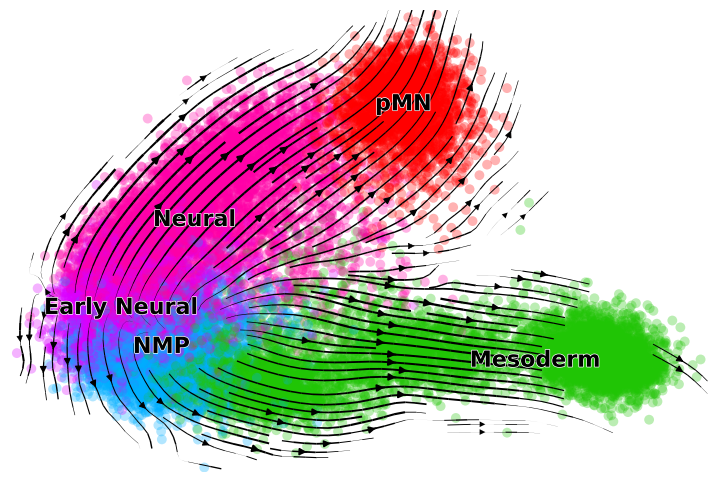

In [12]:
X = model.adata_manager.get_from_registry("X")
X = X.A if issparse(X) else X

x = torch.tensor(X, device='cuda')
b = torch.arange(X.shape[0], device='cuda')

z = model.module.inference(x, b)['z']
v = model.module.vf(z)

pca = PCA(n_components=10)
zs = z.detach().cpu().numpy()
zfs = (z+v).detach().cpu().numpy()
z_pca = pca.fit_transform(zs)
zf_pca = pca.transform(zfs)
v_pca = zf_pca - z_pca

copy = model.adata.copy()
copy.obsm['X_vae'] = z_pca
copy.obsm['velocity_vae'] = v_pca
copy.uns["velocity_params"] = {'embeddings':'vae'}

fig = plt.figure(figsize=(9,6))

ax = fig.subplots()

scv.pl.velocity_embedding_stream(
    copy, 
    basis='vae', 
    title="",
    color='cell_annotation', 
    show=False,
    ax=ax,
    palette=colpal.celltype,
    size=200,
    fontsize=16, 
    legend_fontsize=16, components='1,2'
)
plt.show()

In [13]:
model.module.to('cuda')
model.get_latent_dynamics(return_data=False)

### save & reload

In [14]:
model.adata.write_h5ad('../data/nmp_data_1606.h5ad')
model.save("../models", prefix='nmp_vf_1606_', overwrite=True)

In [15]:
nmp = sc.read_h5ad('../data/nmp_data_1606.h5ad')

state_path = '../models/nmp_vf_1606_model.pt'

vt.md.Velvet.setup_anndata(nmp, x_layer='total', n_layer='new', knn_layer='knn_index')

model = vt.md.Velvet(
    nmp,
    n_latent = 50,
    linear_decoder = True,
    neighborhood_space="latent_space",
    biophysical_model = "full",
    gamma_mode = "learned",
    labelling_time = 2.0,
)

model.setup_model()

trained_state = torch.load(state_path)['model_state_dict']

model.module.load_state_dict(trained_state)

INFO     Generating sequential column names                                                                        


<All keys matched successfully>

In [16]:
model.module = model.module.to('cuda')

mp = vt.sb.MarkovProcess(
    model,
    n_neighbors=10,
    use_space='latent_space',
    use_spline=True,
    use_similarity=False
)

KNN indices for Velvet stored in .obsm['knn_index'].


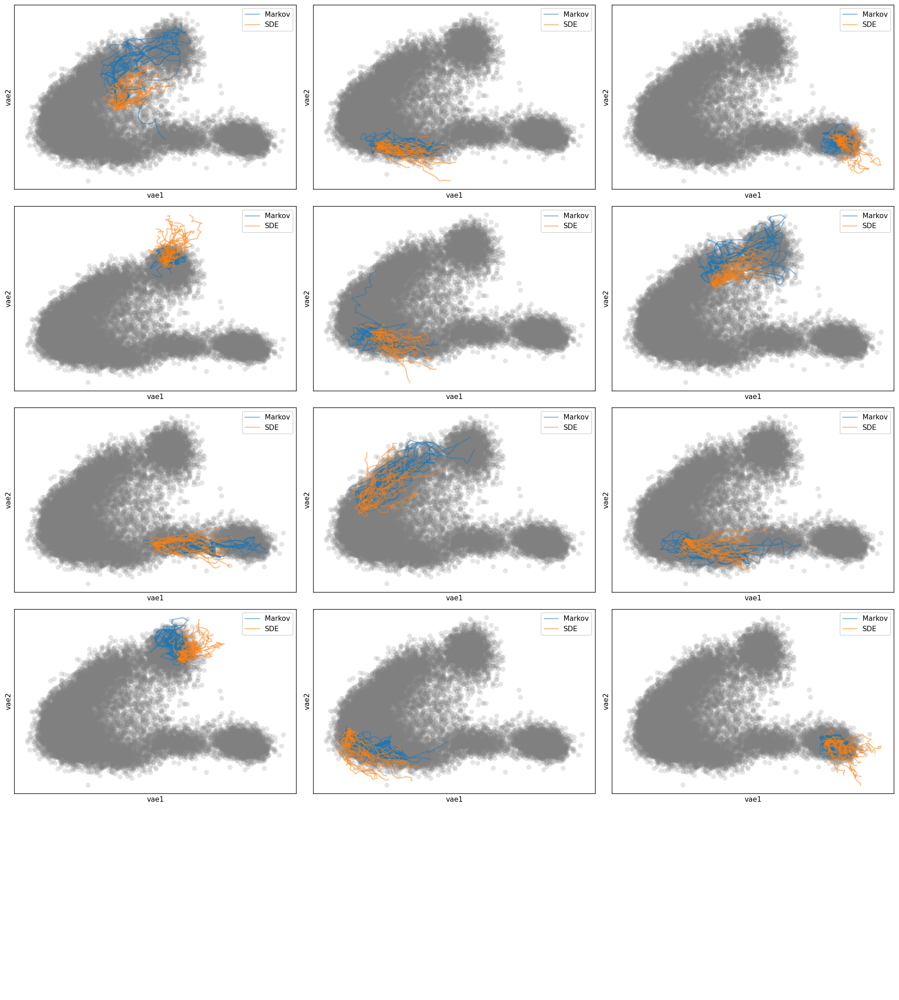

In [17]:
vt.pl.compare_simulation_noise(
    model,
    mp,
    n_repeats=20,
    n_steps=30,
    t_max=20,
    noise_scalar=0.2,
    dt=0.5,
    n_markov_steps=15,
    n_neighbors=10,
    n_tests=12,
)

In [18]:
model.module = model.module.to('cuda')

mp = vt.sb.MarkovProcess(
    model,
    n_neighbors=10,
    use_space='latent_space',
    use_spline=True,
    use_similarity=False
)

sde = vt.sb.SDE(
    model.module.n_latent,
    prior_vectorfield=model.module.vf,
    noise_scalar=0.2,
    device=model.device
)

model.adata.obs['index'] = np.arange(model.adata.shape[0])

vt.sm.VelvetSDE.setup_anndata(
    model, 
    x_layer='total', 
    index_key='index'
)

sde_model = vt.sm.VelvetSDE(
    model,
    sde,
    mp,
)

sde_model.module = sde_model.module.to('cuda')

KNN indices for Velvet stored in .obsm['knn_index'].


In [19]:
sde_model.train(
    max_epochs = 250,
    n_trajectories = 200,
    n_simulations = 50,
    n_steps = 30,
    n_markov_steps=15,
    t_max=25,
    dt = 1.0,
    lr = 0.001,
)

Multiprocessing is handled by SLURM.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
SLURM auto-requeueing enabled. Setting signal handlers.


Epoch 250/250: 100%|██████████| 250/250 [01:47<00:00,  2.26it/s, loss=104, v_num=1] 

`Trainer.fit` stopped: `max_epochs=250` reached.


Epoch 250/250: 100%|██████████| 250/250 [01:47<00:00,  2.32it/s, loss=104, v_num=1]


In [23]:
sde_model.module.sde.noise_scalar = 0.1

sde_untrained = vt.sb.SDE(
    model.module.n_latent,
    prior_vectorfield=model.module.vf,
    noise_scalar=0.1,
    device=model.device
)

vt.sm.VelvetSDE.setup_anndata(
    model, 
    x_layer='total', 
    index_key='index'
)

sde_model_untrained = vt.sm.VelvetSDE(
    model,
    sde_untrained,
    mp,
)

In [24]:
n_trajectories = 1000
n_steps = 200
t_max = 60
dt = 1.0
beginning_pct = 20
components=[0,1]
one_color=False
alpha=0.2

z = torch.tensor(sde_model.adata.obsm['X_z'])

z_data = sde_model.adata[sde_model.adata.obs.timepoint=='D3.2']
z_data = z_data[np.random.choice(z_data.shape[0], size=n_trajectories)]
z_sub = z_data.obsm['X_z']
initial_cells = torch.tensor(z_sub, device=sde_model.device)
timespan = torch.linspace(0, t_max, n_steps, device=sde_model.device)

pre_trajectories = torchsde.sdeint_adjoint(
    sde_model_untrained.module.sde,
    initial_cells,
    timespan,
    method="midpoint",
    dt=dt
)

post_trajectories = torchsde.sdeint_adjoint(
    sde_model.module.sde,
    initial_cells,
    timespan,
    method="midpoint",
    dt=dt
)

pca = PCA()
z_pca = pca.fit_transform(z.detach().cpu().numpy())
copy = sde_model.adata.copy()
copy.obsm['X_Z_PCA'] = z_pca
copy.uns["velocity_params"] = {'embeddings':'Z_PCA'}

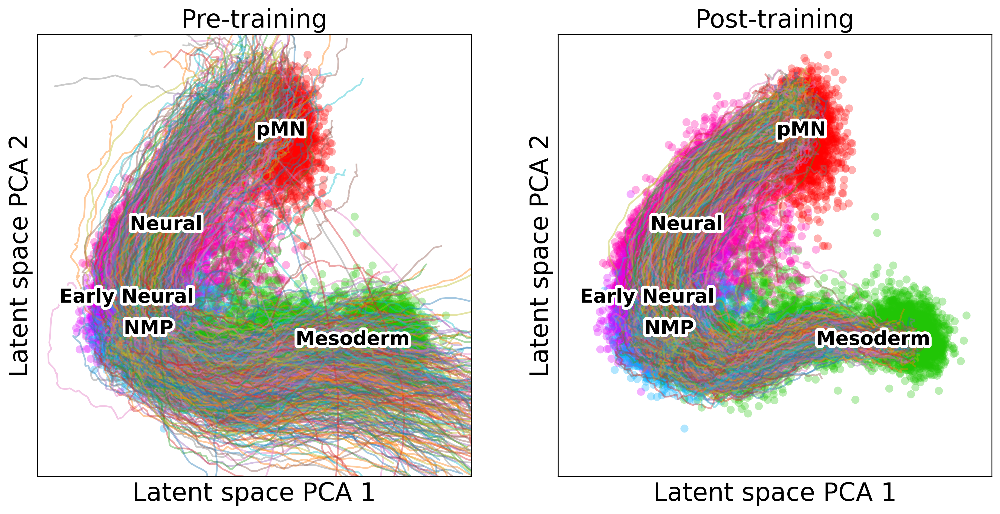

In [25]:
fig = plt.figure(figsize=(15,7), dpi=300)
ax1, ax2 = fig.subplots(1,2)

for trajectories, ax, title in zip(
    [pre_trajectories, post_trajectories],
    [ax1,ax2],
    ['Pre-training','Post-training']
):
    t_pca=[]
    for i in range(n_trajectories):
        ti = trajectories[:,i,:].squeeze().detach().cpu().numpy()
        t_pca.append(pca.transform(ti))
    scv.pl.scatter(copy, basis='Z_PCA', frameon=True, color='cell_annotation', 
                   title=title, palette=colpal.celltype, fontsize=22, legend_fontoutline=5, legend_fontsize=17,
                  ax=ax, size=200, alpha=0.3, show=False, components=f"{components[0]+1},{components[1]+1}")
    for t in t_pca:
        if one_color:
            ax.plot(t[:,components[0]],t[:,components[1]], color='blue', alpha=alpha)
        else:
            ax.plot(t[:,components[0]],t[:,components[1]], alpha=.4)
    ax.set_ylim((-8,10))
    ax.set_xlim((-8,12))
    ax.patch.set_facecolor('red')
    ax.patch.set_alpha(0.0)
    ax.set_xlabel("Latent space PCA 1")
    ax.set_ylabel("Latent space PCA 2")


for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
    
plt.savefig("../figures/2.5.0_NMP_SDE_training.png", bbox_inches='tight')
plt.show()

In [27]:
sde_model.save("../models", prefix='nmp_sde_1606_', overwrite=True)

# Neural

In [27]:
adata0 = vt.pp.read("../data/celltyped_adata.h5ad")
adata0 = adata0[adata0.obs.cell_annotation!='other']

In [28]:
genes_to_include = [
    'Sox2','Pax6','Olig2','Nkx2-2','Nkx6-1','Irx3','Sox1','Olig3',
    'Isl1','Isl2','Neurog2','Sim1','Tubb3','Lhx3','Foxa2',
    'Hes1','Hes5','Nkx2-9','Sp8','Mnx1','Msx1','Slc10a4','Slc18a3'
    'Neurod6','Neurod2','Nfib','Nfia','Zfhx4','Pou2f2','Onecut2',
    'Shh','Arx','Hhip', 'Gas1', 'Cdon', 'Boc', 'Scube2']

In [29]:
neural_types = ['Early_Neural','Neural','MN', 'pMN', 'V3', 'p3','FP']
tps = ['D4', 'D5', 'D6', 'D7', 'D8']

neural = adata0[[ct in neural_types for ct in adata0.obs.cell_annotation]]
neural = neural[[tp in tps for tp in neural.obs.timepoint]]

neural_genes = vt.pp.select_genes(
    neural[neural.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep',
    curated_list=genes_to_include
)

neural = vt.pp.size_normalize(
    neural, 
    genes=neural_genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

vt.pp.neighborhood(neural, n_neighbors=100)

Using ScanPy methods to calculate distances, indices, connectivities, transitions, ... done! 
KNN indices for Velvet stored in .obsm['knn_index'].
Dense similarity transition matrix for Velvet stored in .obsm['Ts'].


In [30]:
neural = neural.copy()

vt.ut.set_seed(0)

vt.md.Velvet.setup_anndata(neural, x_layer='total', n_layer='new', knn_layer='knn_index')

model = vt.md.Velvet(
    neural,
    n_latent = 50,
    linear_decoder = True,
    neighborhood_space="latent_space",
    biophysical_model = "full",
    gamma_mode = "learned",
    labelling_time = 2.0,
)

model.setup_model()

INFO     Generating sequential column names                                                                        


In [31]:
model.train(
    batch_size = neural.shape[0],
    max_epochs = 1000, 
    freeze_vae_after_epochs = 200,
    constrain_vf_after_epochs = 200,
    lr=0.001,
)

Multiprocessing is handled by SLURM.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
SLURM auto-requeueing enabled. Setting signal handlers.


Epoch 1000/1000: 100%|██████████| 1000/1000 [04:47<00:00,  3.39it/s, loss=1.76, v_num=1]  

`Trainer.fit` stopped: `max_epochs=1000` reached.


Epoch 1000/1000: 100%|██████████| 1000/1000 [04:47<00:00,  3.47it/s, loss=1.76, v_num=1]


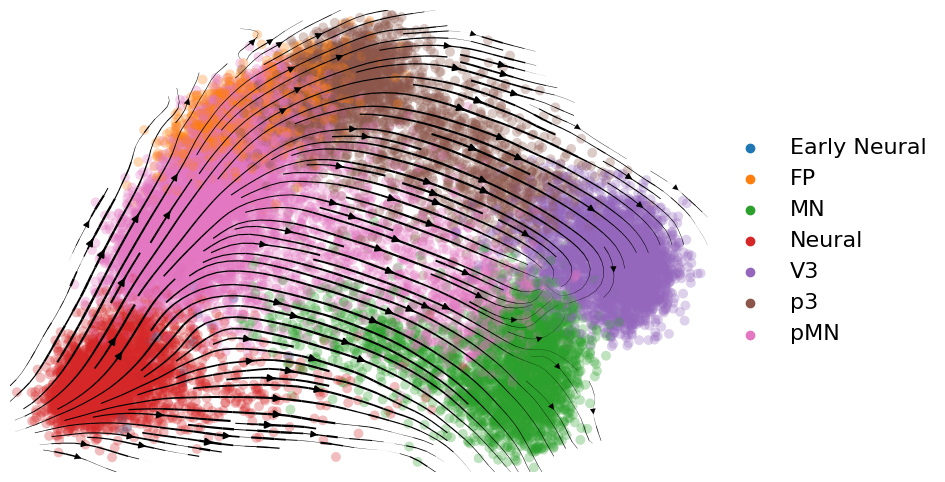

In [32]:
X = model.adata_manager.get_from_registry("X")
X = X.A if issparse(X) else X

x = torch.tensor(X, device='cuda')
b = torch.arange(X.shape[0], device='cuda')

z = model.module.inference(x, b)['z']
v = model.module.vf(z)

pca = PCA(n_components=10)
zs = z.detach().cpu().numpy()
zfs = (z+v).detach().cpu().numpy()
z_pca = pca.fit_transform(zs)
zf_pca = pca.transform(zfs)
v_pca = zf_pca - z_pca

copy = model.adata.copy()
copy.obsm['X_vae'] = z_pca
copy.obsm['velocity_vae'] = v_pca
copy.uns["velocity_params"] = {'embeddings':'vae'}

fig = plt.figure(figsize=(9,6))

ax = fig.subplots()

scv.pl.velocity_embedding_stream(
    copy, 
    basis='vae', 
    title="",
    color='cell_annotation', 
    show=False,
    ax=ax,
#     palette=colpal.celltype,
    size=200,
    fontsize=16,  legend_loc='right margin',
    legend_fontsize=16, components='1,2'
)
plt.show()

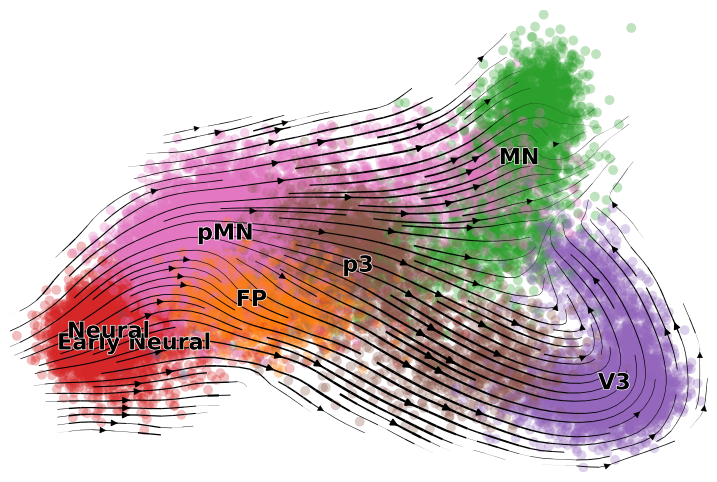

In [33]:
fig = plt.figure(figsize=(9,6))

ax = fig.subplots()

scv.pl.velocity_embedding_stream(
    copy, 
    basis='vae', 
    title="",
    color='cell_annotation', 
    show=False,
    ax=ax,
#     palette=colpal.celltype,
    size=200,
    fontsize=16, 
    legend_fontsize=16, components='1,4'
)
plt.show()

In [34]:
model.module.to('cuda')
model.get_latent_dynamics(return_data=False)

In [35]:
# model.adata.write_h5ad('../data/neural_data_0505.h5ad')
# model.save("../models", prefix='neural_vf_0505_', overwrite=True)

In [36]:
# neural = sc.read_h5ad('../data/neural_data_0505.h5ad')

# state_path = '../models/neural_vf_0505_model.pt'

# vt.md.Velvet.setup_anndata(neural, x_layer='total', n_layer='new', knn_layer='knn_index')

# model = vt.md.Velvet(
#     neural,
#     n_latent = 50,
#     linear_decoder = True,
#     neighborhood_space="latent_space",
#     biophysical_model = "full",
#     gamma_mode = "learned",
#     labelling_time = 2.0,
# )

# model.setup_model()

# trained_state = torch.load(state_path)['model_state_dict']

# model.module.load_state_dict(trained_state)

KNN indices for Velvet stored in .obsm['knn_index'].


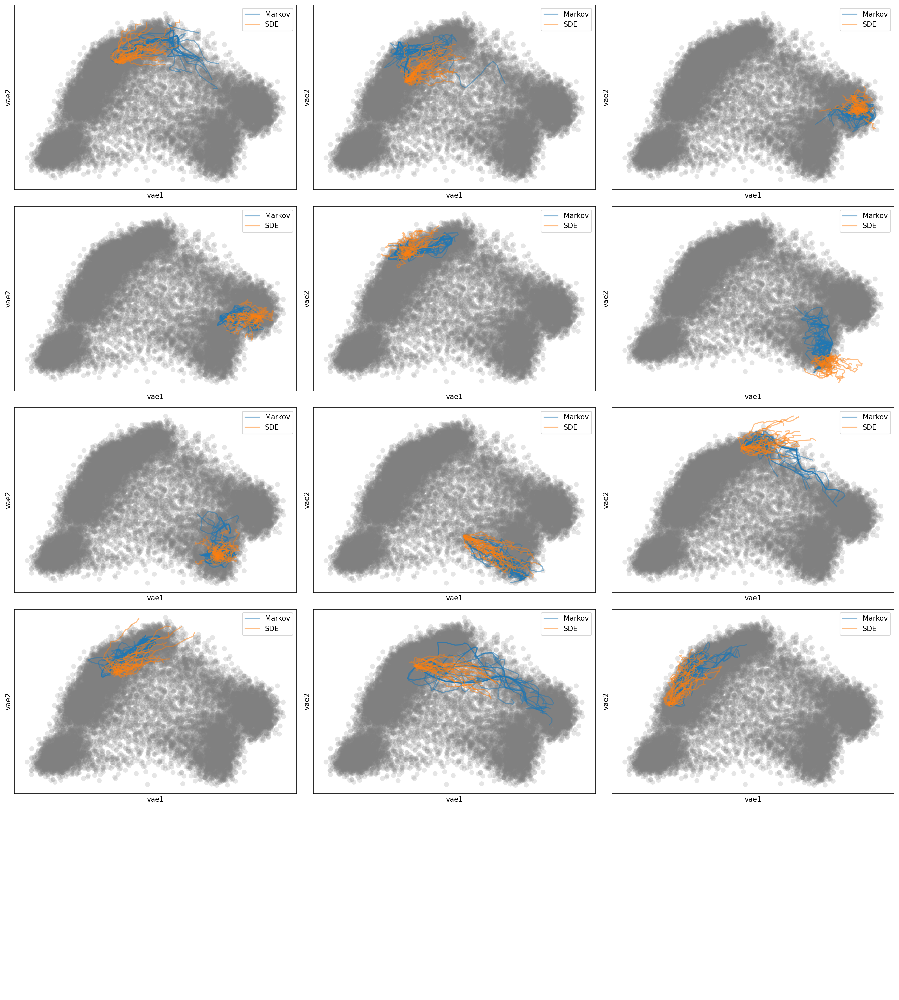

In [37]:
model.module = model.module.to('cuda')

mp = vt.sb.MarkovProcess(
    model,
    n_neighbors=10,
    use_space='latent_space',
    use_spline=True,
    use_similarity=False
)

vt.pl.compare_simulation_noise(
    model,
    mp,
    n_repeats=20,
    n_steps=30,
    t_max=20,
    noise_scalar=0.2,
    dt=0.5,
    n_markov_steps=15,
    n_neighbors=10,
    n_tests=12,
)

Wrapper for velocity pseudotime calculated by scVelo.
Authors: Volker Bergen, Marius Lange, Stefan Peidli, F. Alexander Wolf & Fabian J. Theis
Paper: https://www.nature.com/articles/s41587-020-0591-3
computing velocity graph (using 1/80 cores)


  0%|          | 0/20101 [00:00<?, ?cells/s]

    finished (0:00:10) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 3 regions of root cells and 2 regions of end points .
    finished (0:00:03) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


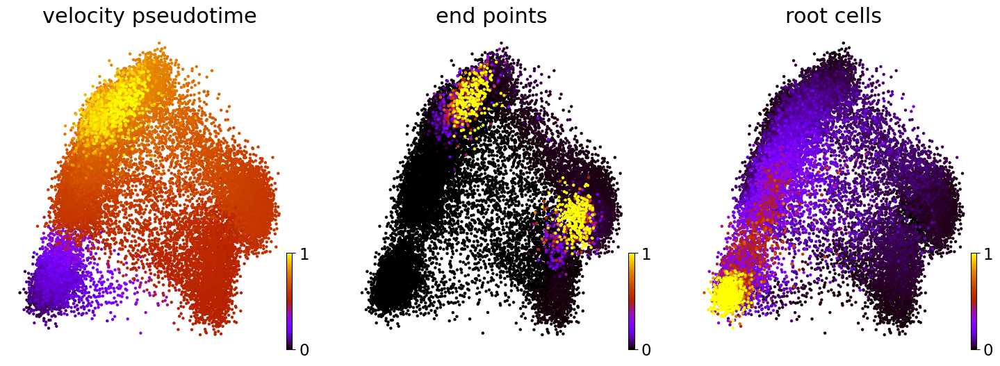

In [38]:
model.module.to('cuda')
model.infer_pseudotime()

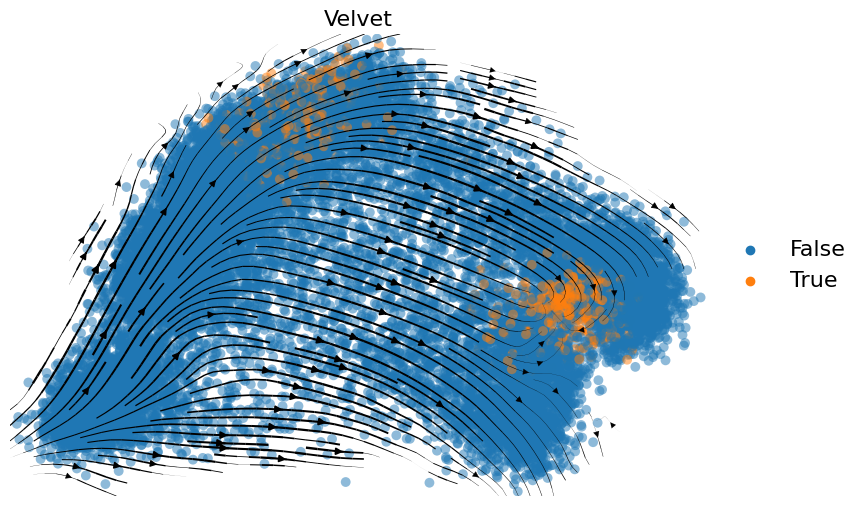

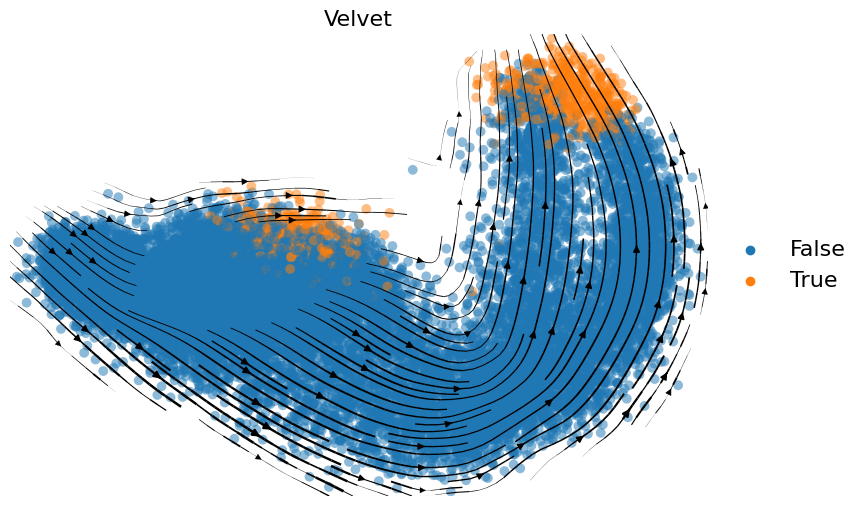

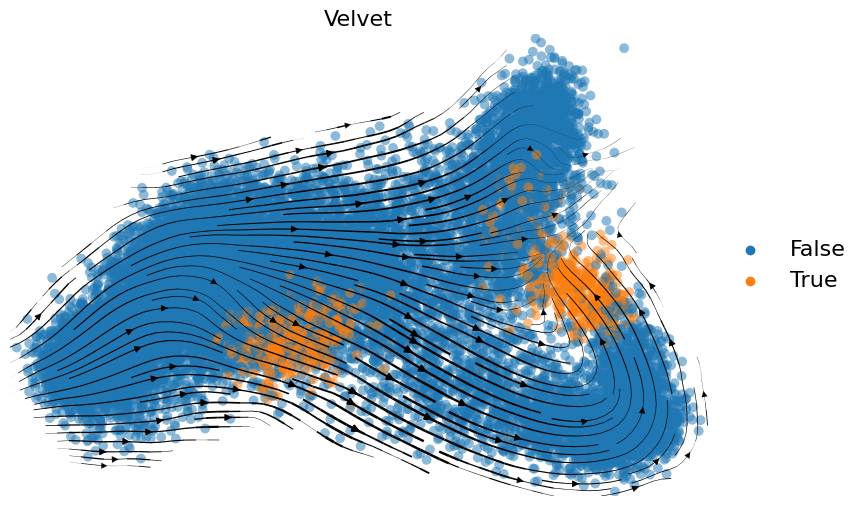

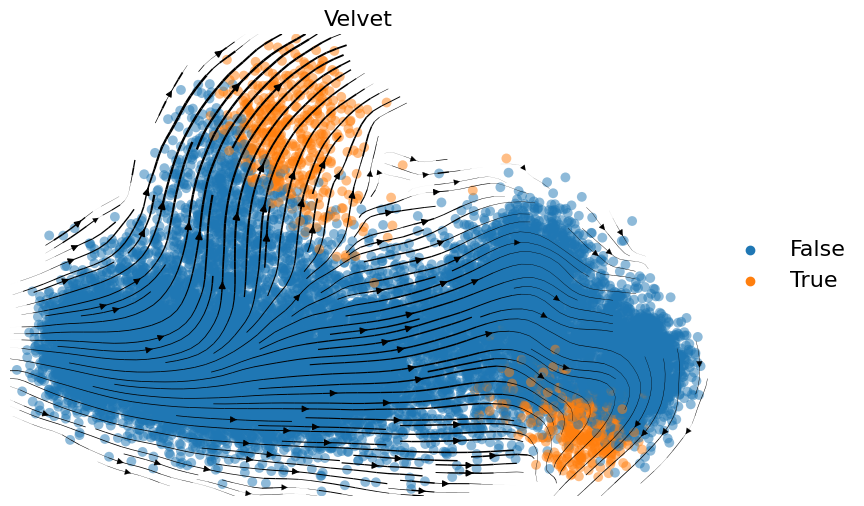

In [52]:
model.adata.obs['terminal_state'] = model.adata.obs['end_points'] > 0.2
x = vt.pl.quick_visualisation(model, color='terminal_state', components='1,2')
x = vt.pl.quick_visualisation(model, color='terminal_state', components='1,3')
x = vt.pl.quick_visualisation(model, color='terminal_state', components='1,4')
x = vt.pl.quick_visualisation(model, color='terminal_state', components='1,5')


In [53]:
model.module = model.module.to('cuda')

mp = vt.sb.MarkovProcess(
    model,
    n_neighbors=10,
    use_space='latent_space',
    use_spline=True,
    use_similarity=False,
    terminal_state_key='terminal_state',
)

sde = vt.sb.SDE(
    model.module.n_latent,
    prior_vectorfield=model.module.vf,
    noise_scalar=0.2,
    device=model.device
)

model.adata.obs['index'] = np.arange(model.adata.shape[0])

vt.sm.VelvetSDE.setup_anndata(
    model, 
    x_layer='total', 
    index_key='index'
)

sde_model = vt.sm.VelvetSDE(
    model,
    sde,
    mp,
)

sde_model.module = sde_model.module.to('cuda')

KNN indices for Velvet stored in .obsm['knn_index'].


In [54]:
sde_model.module = sde_model.module.to('cuda')
sde_model.train(
    max_epochs = 250,
    n_trajectories = 200,
    n_simulations = 50,
    n_steps = 30,
    n_markov_steps=15,
    t_max=25,
    dt = 1.0,
    lr = 0.001,
)

Multiprocessing is handled by SLURM.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
SLURM auto-requeueing enabled. Setting signal handlers.


Epoch 250/250: 100%|██████████| 250/250 [01:33<00:00,  2.79it/s, loss=53.4, v_num=1]

`Trainer.fit` stopped: `max_epochs=250` reached.


Epoch 250/250: 100%|██████████| 250/250 [01:33<00:00,  2.67it/s, loss=53.4, v_num=1]


In [55]:
sde_model.module.sde.noise_scalar = 0.1

In [56]:
sde_untrained = vt.sb.SDE(
    model.module.n_latent,
    prior_vectorfield=model.module.vf,
    noise_scalar=0.1,
    device=model.device
)

vt.sm.VelvetSDE.setup_anndata(
    model, 
    x_layer='total', 
    index_key='index'
)

sde_model_untrained = vt.sm.VelvetSDE(
    model,
    sde_untrained,
    mp,
)

In [57]:
n_trajectories = 1000
n_steps = 200
t_max = 100
dt = 1.0
beginning_pct = 20
components=[0,1]
one_color=False
alpha=0.2

z = torch.tensor(sde_model.adata.obsm['X_z'], device=model.device)

z_data = sde_model.adata[[ca in ['Early_Neural','Neural'] for ca in sde_model.adata.obs.cell_annotation]]
z_data = z_data[np.random.choice(z_data.shape[0], size=n_trajectories)]
z_sub = z_data.obsm['X_z']
initial_cells = torch.tensor(z_sub, device=sde_model.device)
timespan = torch.linspace(0, t_max, n_steps, device=sde_model.device)

pre_trajectories = torchsde.sdeint_adjoint(
    sde_model_untrained.module.sde,
    initial_cells,
    timespan,
    method="midpoint",
    dt=dt
)

post_trajectories = torchsde.sdeint_adjoint(
    sde_model.module.sde,
    initial_cells,
    timespan,
    method="midpoint",
    dt=dt
)

pca = PCA()
z_pca = pca.fit_transform(z.detach().cpu().numpy())
copy = sde_model.adata.copy()
copy.obsm['X_Z_PCA'] = z_pca
copy.uns["velocity_params"] = {'embeddings':'Z_PCA'}

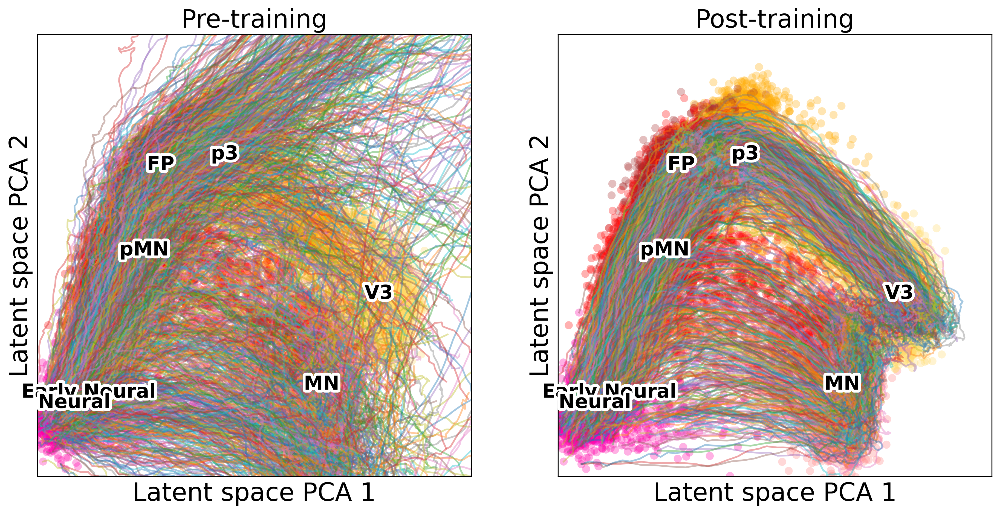

In [71]:
fig = plt.figure(figsize=(15,7), dpi=300)
ax1, ax2 = fig.subplots(1,2)

components=[0,1]

for trajectories, ax, title in zip(
    [pre_trajectories, post_trajectories],
    [ax1,ax2],
    ['Pre-training','Post-training']
):
    t_pca=[]
    for i in range(n_trajectories):
        ti = trajectories[:,i,:].squeeze().detach().cpu().numpy()
        t_pca.append(pca.transform(ti))
    scv.pl.scatter(copy, basis='Z_PCA', frameon=True, color='cell_annotation', 
                   title=title, palette=colpal.celltype, fontsize=22, legend_fontoutline=5, legend_fontsize=17,
                  ax=ax, size=200, alpha=0.3, show=False, components=f"{components[0]+1},{components[1]+1}")
    for t in t_pca:
        if one_color:
            ax.plot(t[:,components[0]],t[:,components[1]], color='blue', alpha=alpha)
        else:
            ax.plot(t[:,components[0]],t[:,components[1]], alpha=.4)
    ax.set_ylim((-8,10))
    ax.set_xlim((-8,12))
    ax.patch.set_facecolor('red')
    ax.patch.set_alpha(0.0)
    ax.set_xlabel("Latent space PCA 1")
    ax.set_ylabel("Latent space PCA 2")
    
for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
    
plt.savefig("../figures/2.5.1_Neural_SDE_training.png", bbox_inches='tight')
plt.show()

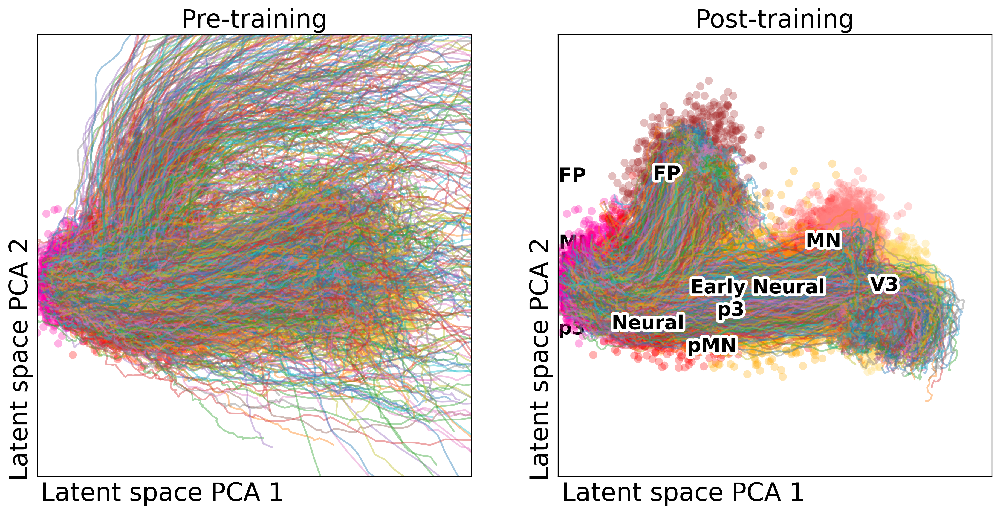

In [70]:
from adjustText import adjust_text

fig = plt.figure(figsize=(15,7), dpi=300)
ax1, ax2 = fig.subplots(1,2)

components=[0,4]

for trajectories, ax, title in zip(
    [pre_trajectories, post_trajectories],
    [ax1,ax2],
    ['Pre-training','Post-training']
):
    t_pca=[]
    for i in range(n_trajectories):
        ti = trajectories[:,i,:].squeeze().detach().cpu().numpy()
        t_pca.append(pca.transform(ti))
    scv.pl.scatter(copy, basis='Z_PCA', frameon=True, color='cell_annotation', 
                   title=title, palette=colpal.celltype, fontsize=22, legend_fontoutline=5, legend_fontsize=17,
                  ax=ax, size=200, alpha=0.3, show=False, components=f"{components[0]+1},{components[1]+1}")
    for t in t_pca:
        if one_color:
            ax.plot(t[:,components[0]],t[:,components[1]], color='blue', alpha=alpha)
        else:
            ax.plot(t[:,components[0]],t[:,components[1]], alpha=.4)
    ax.set_ylim((-8,10))
    ax.set_xlim((-8,12))
    ax.patch.set_facecolor('red')
    ax.patch.set_alpha(0.0)
    ax.set_xlabel("Latent space PCA 1                       ")
    ax.set_ylabel("Latent space PCA 2                          ")
    
    
    texts = []

    for ax in fig.axes:
        for text in ax.texts:
            texts.append(text)
            
    adjust_text(texts)


    
plt.show()

In [60]:
model.adata.write_h5ad('../data/neural_data_0606.h5ad')
model.save("../models", prefix='neural_vf_0606_', overwrite=True)
sde_model.save("../models", prefix='neural_sde_0606_', overwrite=True)